# DSI DataFest 2018

*Alex Jurgens, Ariadna Venegas-Li, Ryan James*

In [98]:
from __future__ import division

from six.moves import zip_longest

from collections import namedtuple
from datetime import date
import re

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd

from PIL import Image
import pytesseract as tess
import cv2

In [55]:
FILENAME = 'UCD_Lehmann_0036.jpg'
THRESHOLD = 192
SCALE = 800
BUFFER = 50

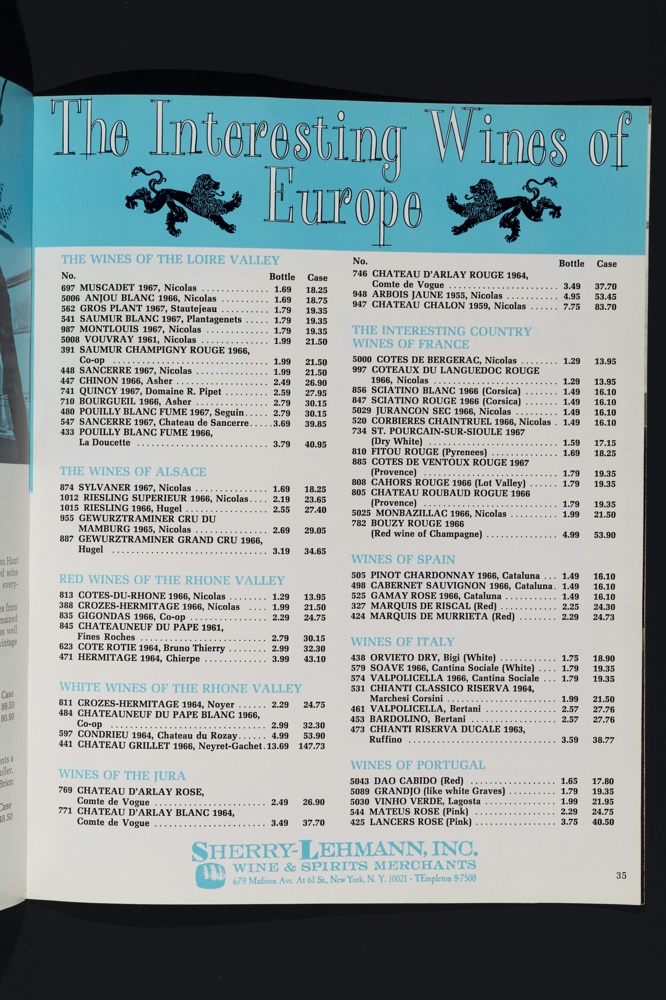

In [57]:
Image.open(FILENAME)

## Test Image

### Cropping the Image

Here we crop the image to focus on just the catalog part. Doing so improves the results of running Tesseract (the OCR).

In [35]:
def get_bw_image_1(image, threshold=THRESHOLD):
    """
    """
    thresh, image_bw = cv2.threshold(image, threshold, 255, cv2.THRESH_TRIANGLE)
    return image_bw

In [36]:
def get_bw_image_2(image):
    """
    """
    # Bilateral filter preserve edges
    image_filtered = cv2.bilateralFilter(image,
                                         15,
                                         50,
                                         75,
                                        )

    # Create black and white image based on adaptive threshold
    image_bw = cv2.adaptiveThreshold(image_filtered,
                                     255,                             # max value in image
                                     cv2.ADAPTIVE_THRESH_GAUSSIAN_C,  # adaptive type
                                     cv2.THRESH_BINARY,               # type of thresholding
                                     51,                              # kernel size
                                     4,                               # some constant
                                    )
    return image_bw

In [37]:
def resize(image, height=SCALE):
    """
    Resize image to given height
    """
    ratio = height / image.shape[0]
    return cv2.resize(image, (int(ratio * image.shape[1]), height))

In [38]:
def detect_edges(image):
    """
    """
    # Median filter clears small details
    image = cv2.medianBlur(image,
                           11,
                          )

    # Add black border in case that page is touching an image border
    image_border = cv2.copyMakeBorder(image, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=[0, 0, 0])
    image_edges = cv2.Canny(image_border, 200, 250)
    
    return image_edges

In [39]:
def fourCornersSort(pts):
    """
    Sort corners: top-left, bot-left, bot-right, top-right
    """
    # Difference and sum of x and y value
    diff = np.diff(pts, axis=1)
    summ = pts.sum(axis=1)
    # Top-left point has smallest sum...
    # np.argmin() returns INDEX of min
    return np.array([pts[np.argmin(summ)],
                     pts[np.argmax(diff)],
                     pts[np.argmax(summ)],
                     pts[np.argmin(diff)]])

In [40]:
def contourOffset(cnt, offset):
    """
    Offset contour, by 5px border
    """
    # Matrix addition
    cnt += offset
    # if value < 0 => replace it by 0
    cnt[cnt < 0] = 0
    return cnt

In [41]:
def _crop_image(image, edges):
    """
    """
    # Getting contours
    im2, contours, hierarchy = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # Finding contour of biggest rectangle
    # Otherwise return corners of original image
    # Don't forget on our 5px border!
    height, width = edges.shape
    MAX_COUNTOUR_AREA = (width - 10) * (height - 10)

    # Page fill at least half of image, then saving max area found
    maxAreaFound = MAX_COUNTOUR_AREA * 0.3

    # Saving page contour
    pageContour = np.array([[5, 5], [5, height-5], [width-5, height-5], [width-5, 5]])

    # Go through all contours
    for cnt in contours:
        # Simplify contour
        perimeter = cv2.arcLength(cnt, True)
        approx = cv2.approxPolyDP(cnt, 0.03 * perimeter, True)

        # Page has 4 corners and it is convex
        # Page area must be bigger than maxAreaFound 
        if (len(approx) == 4 and
                cv2.isContourConvex(approx) and
                maxAreaFound < cv2.contourArea(approx) < MAX_COUNTOUR_AREA):

            maxAreaFound = cv2.contourArea(approx)
            pageContour = approx

    # Sort and offset corners
    pageContour = fourCornersSort(np.squeeze(pageContour))
    pageContour = contourOffset(pageContour, (-5, -5))

    # # Recalculate to original scale - start Points
    sPoints = pageContour.dot(image.shape[0]/SCALE)

    # Using Euclidean distance
    # Calculate maximum height (maximal length of vertical edges) and width
    height = max(np.linalg.norm(sPoints[0] - sPoints[1]),
                 np.linalg.norm(sPoints[2] - sPoints[3]))
    width  = max(np.linalg.norm(sPoints[1] - sPoints[2]),
                 np.linalg.norm(sPoints[3] - sPoints[0]))

    # Create target points
    tPoints = np.array([[0, 0],
                        [0, height],
                        [width, height],
                        [width, 0]], np.float32)

    # getPerspectiveTransform() needs float32
    if sPoints.dtype != np.float32:
        sPoints = sPoints.astype(np.float32)

    # Wraping perspective
    M = cv2.getPerspectiveTransform(sPoints, tPoints) 
    new_image = cv2.warpPerspective(image, M, (int(width), int(height)))
    
    return new_image

In [42]:
def crop_image(image):
    image_bw = get_bw_image_1(image)
    image_bw_resize = resize(image_bw)
    image_edges = detect_edges(image_bw_resize)
    cropped_image = _crop_image(image_bw, image_edges)
    return cropped_image

## Splitting Into Columns

In [45]:
def get_ocr_data(image, config=''):
    """
    """
    data = tess.image_to_data(Image.fromarray(image), lang='eng', config=config)
    
    df = [line.split() for line in data.splitlines()]
    df = pd.DataFrame(df[1:], columns=df[0])
    
    columns = ['level', 'page_num', 'block_num', 'par_num', 'line_num', 'word_num', 'left', 'top', 'width', 'height', 'conf']
    df[columns] = df[columns].apply(pd.to_numeric)
    
    return df

In [46]:
def to_string(thing):
    try:
        return str(thing).lower()
    except:
        return ''

In [47]:
def get_columns(image, conf=70):
    """
    """
    lefts, rights = set(), set()
    
    for mode in ['1', '6', '11']:
        data = get_ocr_data(image, config=f'--psm {mode}')

        data.text = data.text.apply(to_string)

        nos = data[(data.text == "no.") & (data.conf >= conf)]
        cases = data[(data.text == "case") & (data.conf >= conf)]
    
        lefts_ = set(nos.left.values.tolist())
        rights_ = set((cases.left + cases.width).values.tolist())
        
        lefts |= lefts_
        rights |= rights_
    
    columns = list(zip_longest(sorted(lefts), sorted(rights)))
    
    return columns

## Get Page Text

In [62]:
def get_page_text(image, buffer=BUFFER, mode=6):
    """
    """
    cropped = crop_image(image)
    texts = []
    for left, right in get_columns(cropped):
        new_left, new_right = left - buffer, right + buffer
        text = tess.image_to_string(cropped[:, new_left:new_right], config=f'--psm {mode}')
        texts.append(text)
    page_text = ''.join(texts)
    return page_text

## Extract Wine Information

In [135]:
WINE_REGEX = r"""
^                                   # beginning of the line
[\W]{0,5}?                          # leading junk (any non-alphanumeric)
(?P<num>\d+)                        # the database number
\W*?                                # seperating non-alphanumerics
(?P<name>(?:[^,\d\s]{2,}\s?)+)      # the name of the wine
[^,\d]*                             # non-comma, non-digit seperator
(?P<vintage>\d{4})?                 # the four-digit vintage
.*?                                 # seperators
(?P<winery>(?:\w+\s?)+)?            # the winery
\W*                                 # non-alphanumeric seperator
(?P<bottle>\d+\.\d{2})              # the bottle price: at least one digit, a period, two digits
.*?                                 # seperators
(?P<case>\d+\.\d{2})                # the case price: at least one digit, a period, two digits
.*?                                 # trailing junk
$                                   # end of line
"""

wine_regex = re.compile(WINE_REGEX, re.MULTILINE|re.DOTALL|re.VERBOSE)

In [155]:
def extract_wines(image):
    """
    """
    text = get_page_text(image)
    
    wines = pd.DataFrame(wine_regex.findall(text), columns=['num', 'name', 'vintage', 'winery', 'bottle', 'case'])
    wines[['vintage', 'bottle', 'case']] = wines[['vintage', 'bottle', 'case']].apply(pd.to_numeric)
    wines.name = wines.name.str.strip(' .')
    wines.name = wines.name.str.replace('\n', '')
    
    return wines

## Testing

In [156]:
image = cv2.imread(FILENAME, cv2.IMREAD_GRAYSCALE)

In [157]:
extract_wines(image)

,num,name,vintage,winery,bottle,case
0,697,MUSCADET,1967.0,Nicolas,1.69,18.25
1,5006,ANIOU BLANC,1966.0,Nicolas,1.69,18.75
2,562,GROS PLANT,1967.0,Stauteieau,1.79,19.35
3,541,SAUMUR BLANC,1967.0,Plantagenets,1.79,19.35
4,987,MONTLOUIS,1967.0,Nicolas,1.79,19.35
5,5008,VOUVRAY,1961.0,Nicolas,1.99,21.50
6,391,SAUMUR CHAMPIGNY ROUGE,1966.0,011,1.99,21.50
7,448,SANCERRE,1967.0,Nicolas,1.99,21.50
8,447,CHINON,1966.0,Asher,2.49,26.90
9,741,QUINCY,1967.0,Pipet,2.59,27.95
